Experiment 1

VGG16 OpenCV data augmentation

In [1]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam,SGD
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping

import scipy.io
import numpy as np
import os
from PIL import Image
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [2]:
# Do we have access to a GPU? Sanity Check
device_list = tf.config.list_physical_devices()
if "GPU" in [device.device_type for device in device_list]:
  print(f"[INFO] TensorFlow has GPU available to use. Woohoo!! Computing will be sped up!")
  print(f"[INFO] Accessible devices:\n{device_list}")
else:
  print(f"[INFO] TensorFlow does not have GPU available to use. Models may take a while to train.")
  print(f"[INFO] Accessible devices:\n{device_list}")

[INFO] TensorFlow has GPU available to use. Woohoo!! Computing will be sped up!
[INFO] Accessible devices:
[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [3]:
import os
path = '/kaggle/input/cats-projekat-4/cats_projekat/'
len(os.listdir(path))

5

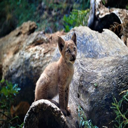

In [4]:
from PIL import Image

im =Image.open('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image100.jpg').resize((128,128))
im

In [5]:
cat_labels = set()

    
for d in os.listdir(path):
    cat_labels.add(d)

In [6]:
len(cat_labels)
num_classes = len(cat_labels)
batch_size = 32

In [7]:
cats_labels = list(cat_labels)
cats_labels_path = [path + s for s in cats_labels]

In [8]:
import cv2
def load_and_preprocess_image(path):
    image = cv2.imread(path)
    image = cv2.resize(image, (224,224))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

In [9]:
X = []
y = []

for type_path, label in zip(cats_labels_path,cats_labels) :
    for image_path in os.listdir(type_path):
        image = load_and_preprocess_image(type_path+"/"+image_path)
        
        X.append(image)
        y.append(label)

3080


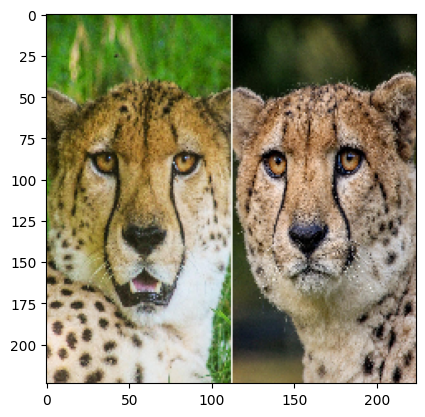

In [10]:
import matplotlib.pyplot as plt
print(len(X))
plt.imshow(X[100])

In [11]:
from sklearn.preprocessing import LabelBinarizer
import numpy as np
encoder = LabelBinarizer()

X = np.array(X)
y = encoder.fit_transform(np.array(y))

In [12]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42, shuffle=True)

In [13]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D
from tensorflow.keras.models import Model, Sequential
base_model=VGG16(weights='imagenet',include_top=False)

x=base_model.output
x=GlobalAveragePooling2D()(x)
x=Dense(1024,activation='relu')(x)
x=Dropout(0.5)(x)
x=Dense(512,activation='relu')(x)
x=Dropout(0.2)(x)
x=Dense(256,activation='relu')(x)
preds=Dense(num_classes,activation='softmax')(x)

model=Model(inputs=base_model.input,outputs=preds)

for layer in model.layers[:-5]:
    layer.trainable=False
for layer in model.layers[-5:]:
    layer.trainable=True
    
model.compile("adam",loss="categorical_crossentropy",metrics=["accuracy"])

print(model.summary())

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, None, None, 64)      │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, None, None, 64)      │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, None, None, 64)      │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, None, None, 128)     │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, None, None, 128)     │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, None, None, 128)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, None, None, 256)     │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, None, None, 256)     │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, None, None, 256)     │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, None, None, 256)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, None, None, 512)     │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, None, None, 512)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, None, None, 512)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 512)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1024)                │         525,3

 Total params: 15,897,413 (60.64 MB)

 Trainable params: 657,413 (2.51 MB)

 Non-trainable params: 15,240,000 (58.14 MB)

None


In [14]:
from tensorflow.keras.callbacks import ReduceLROnPlateau
checkpoint = ModelCheckpoint(
    './base.model.keras',
    monitor='val_loss',
    verbose=1,
    save_best_only=True,
    mode='min',
    save_weights_only=False,
)
earlystop = EarlyStopping(patience=10, verbose=1,restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(factor=0.1, patience=10,verbose=1)

In [15]:
history = model.fit(X_train,y_train,batch_size=batch_size,epochs=50,validation_data=(X_test,y_test), callbacks=[checkpoint,earlystop, reduce_lr])

Epoch 1/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.4617 - loss: 2.8219
Epoch 1: val_loss improved from inf to 0.66833, saving model to ./base.model.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 21s 129ms/step - accuracy: 0.4631 - loss: 2.8072 - val_accuracy: 0.6932 - val_loss: 0.6683 - learning_rate: 0.0010
Epoch 2/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - accuracy: 0.6770 - loss: 0.8515
Epoch 2: val_loss did not improve from 0.66833
77/77 ━━━━━━━━━━━━━━━━━━━━ 6s 77ms/step - accuracy: 0.6769 - loss: 0.8513 - val_accuracy: 0.7224 - val_loss: 0.6685 - learning_rate: 0.0010
Epoch 3/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - accuracy: 0.6900 - loss: 0.7644
Epoch 3: val_loss improved from 0.66833 to 0.59274, saving model to ./base.model.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 6s 81ms/step - accuracy: 0.6901 - loss: 0.7643 - val_accuracy: 0.7549 - val_loss: 0.5927 - learning_rate: 0.0010
Epoch 4/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - accuracy: 0.7297 - loss: 0.6761
Epoch 4: val_loss imp

In [16]:
loss, acc = model.evaluate(X_test,y_test,verbose=0)
print(f"loss on the test set is {loss:.2f}")
print(f"accuracy on the test set is {acc:.3f}")

loss on the test set is 0.48
accuracy on the test set is 0.815


In [17]:
predictions = model.predict(X_test)

20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 79ms/step


In [18]:
label_predictions = encoder.inverse_transform(predictions)

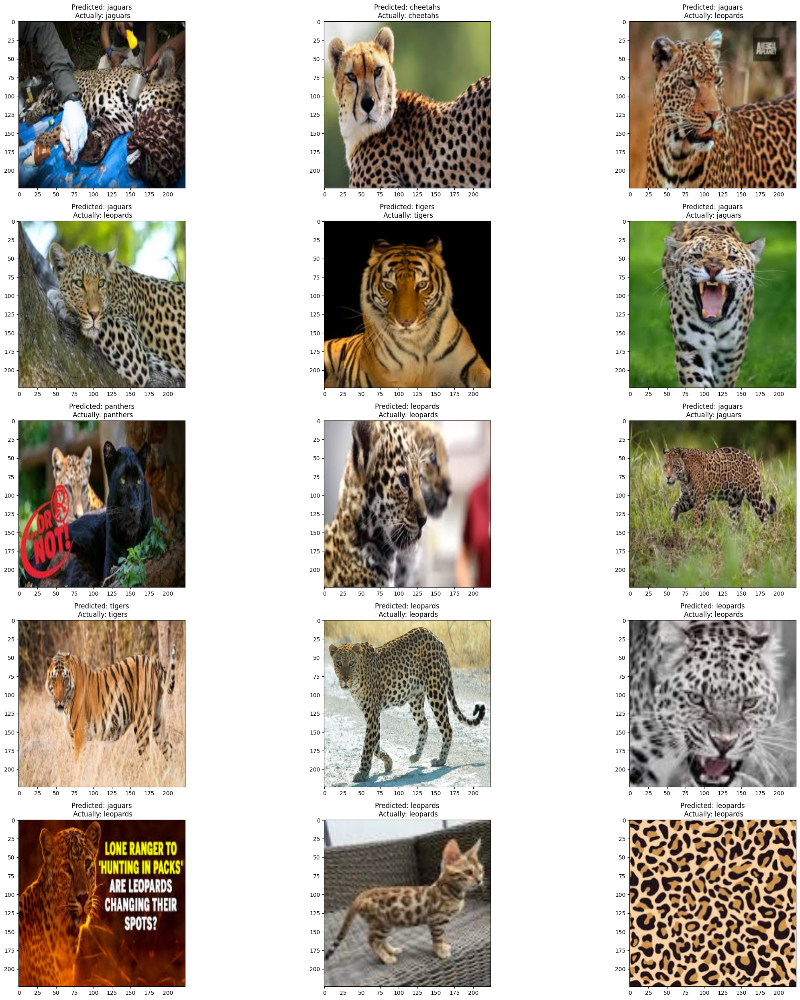

In [19]:
rows, cols = 5, 3
size = 25

fig,ax=plt.subplots(rows,cols)
fig.set_size_inches(size,size)
for i in range(rows):
    for j in range (cols):
        index = np.random.randint(0,len(X_test))
        ax[i,j].imshow(X_test[index])
        ax[i,j].set_title(f'Predicted: {label_predictions[index]}\n Actually: {encoder.inverse_transform(y_test)[index]}')
        
plt.tight_layout()

20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step - accuracy: 0.8150 - loss: 0.4798


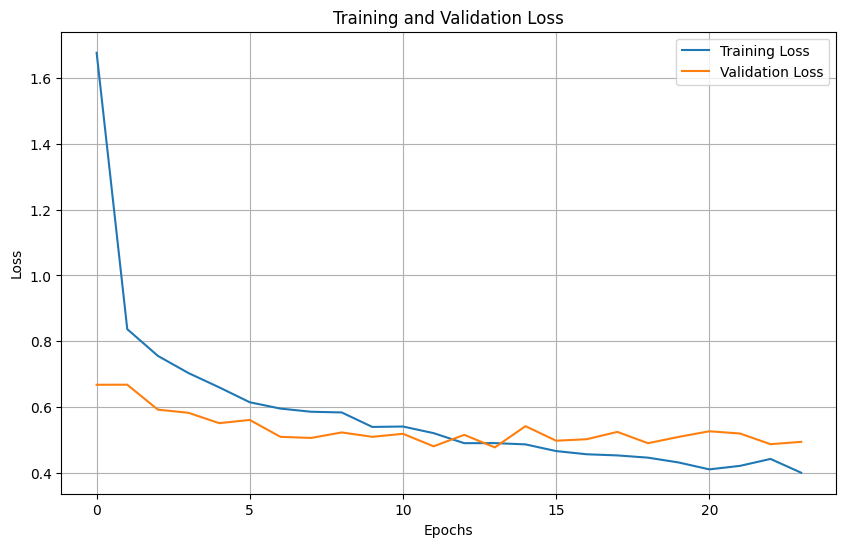

In [20]:
import matplotlib.pyplot as plt
model.evaluate(X_test, y_test)
# Extract loss values from the history object
history_dict = history.history
loss = history_dict['loss']
val_loss = history_dict['val_loss']

# Plot the loss curves
plt.figure(figsize=(10, 6))
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step


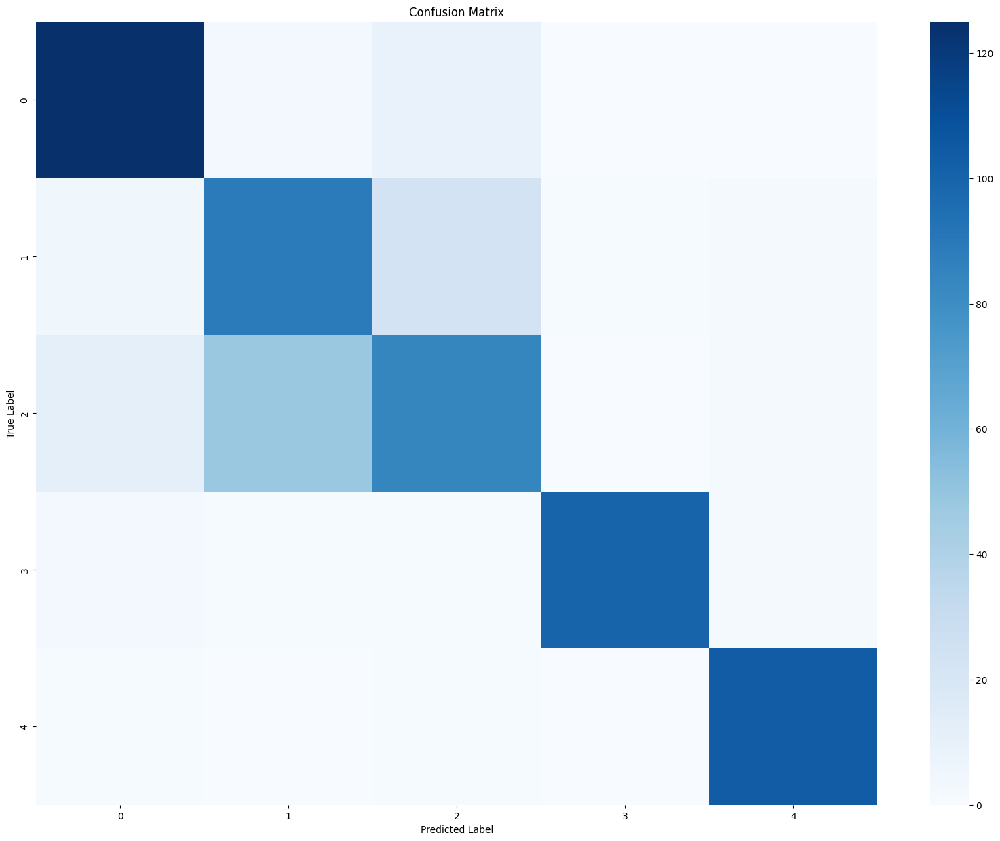

In [21]:
# Create a confusion matrix
# Assuming model predictions and true labels are available
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)  # Convert predictions to class labels
y_true = np.argmax(y_test, axis=1)  # Convert one-hot encoded labels to class labels

conf_matrix = confusion_matrix(y_true, y_pred_classes)
fig, ax = plt.subplots(figsize=(20, 15))  # Adjust figsize for better visibility with 120 classes
sns.heatmap(conf_matrix, annot=False, cmap='Blues', ax=ax)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [22]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, roc_curve, auc
from sklearn.preprocessing import label_binarize
# Print classification report for precision, recall, and F1-score
print("Classification Report:")
print(classification_report(y_true, y_pred_classes))

Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.91      0.88       137
           1       0.63      0.74      0.68       120
           2       0.71      0.58      0.64       146
           3       0.99      0.93      0.96       107
           4       0.95      0.98      0.96       106

    accuracy                           0.81       616
   macro avg       0.83      0.83      0.83       616
weighted avg       0.82      0.81      0.81       616



In [23]:
# Plot ROC AUC curve
n_classes = y_test.shape[1]  # Number of classes
y_test_binarized = label_binarize(y_true, classes=np.arange(n_classes))

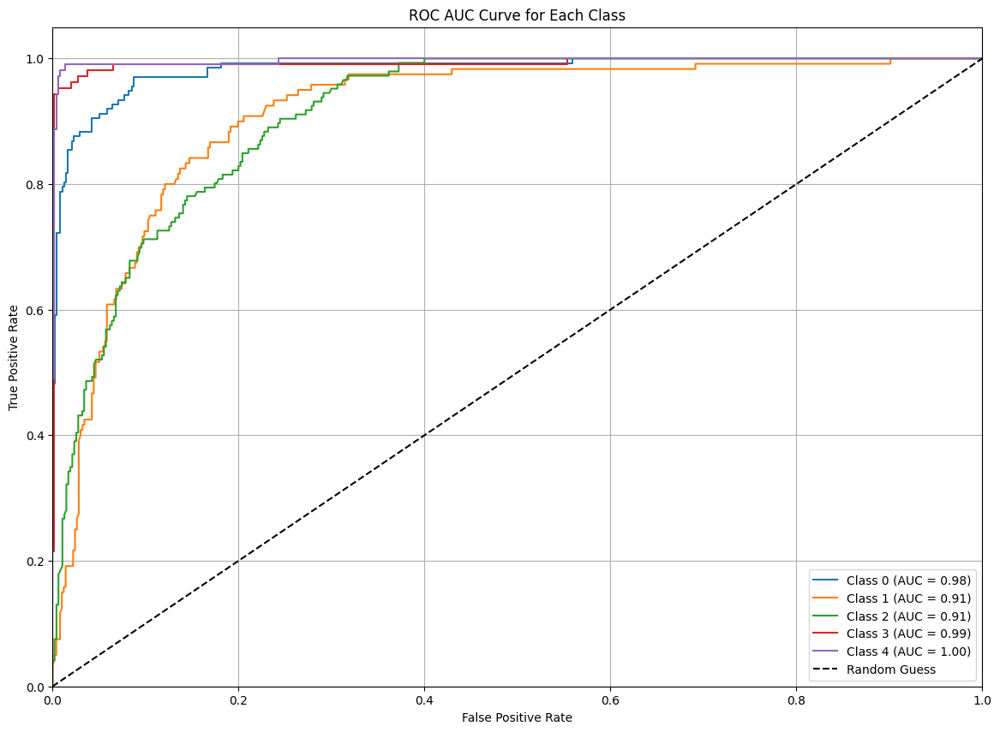

In [24]:
# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_binarized[:, i], y_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot the ROC AUC curve for each class
plt.figure(figsize=(14, 10))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.title('ROC AUC Curve for Each Class')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

**Experiment 2**

***VGG16 - Image Data Augmentator*** 

In [25]:
#batch_size=32##This parameter should Be set according to your GPU/CPU capacity . Else Be Ready FOr Exhaust Error!
#num_classes = 120
image_size = 224
num_channels = 3

In [26]:
!pip install split-folders

In [27]:
import splitfolders
splitfolders.ratio(path, output="output",seed=1337, ratio=(.7, .15,.15), group_prefix=None, move=False) # default values

Copying files: 3080 files [00:04, 728.17 files/s] 


In [28]:
#VGG16
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.vgg16 import preprocess_input
train_dir = '/kaggle/working/output/train'
test_dir = '/kaggle/working/output/test'
val_dir = '/kaggle/working/output/val'
train_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
    )

# Validation/Test data generator without augmentation
valid_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
test_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create validation generator
validation_generator = train_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create test generator
test_generator = valid_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

Found 2154 images belonging to 5 classes.
Found 459 images belonging to 5 classes.
Found 467 images belonging to 5 classes.


In [29]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D,BatchNormalization
from tensorflow.keras.models import Model, Sequential
base_model=VGG16(weights='imagenet',include_top=False, input_shape=(224,224,3))
x = base_model.output
x = Flatten()(x)
x = Dropout(0.4)(x)
# let's add two fully-connected layer
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
# and a softmax layer -- let's say we have 200 classes
predictions = Dense(num_classes, activation='softmax')(x)

# this is the model we will train
model = Model(inputs=base_model.input, outputs=predictions)

# first: train only the top layers (which were randomly initialized)
# i.e. freeze all convolutional InceptionV3 layers
for layer in base_model.layers:
    layer.trainable = False

# compile the model (should be done *after* setting layers to non-trainable)
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

print(model.summary())

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 70,319,941 (268.25 MB)

 Trainable params: 55,597,061 (212.09 MB)

 Non-trainable params: 14,722,880 (56.16 MB)

None


In [30]:
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping, ReduceLROnPlateau
#from tensorflow.keras.optimizers import Adam,SGD
checkpoint = ModelCheckpoint(
    './base.model.keras',
    monitor='val_loss',
    verbose=2,
    save_best_only=True,
    mode='min',
    save_weights_only=False,
)
earlystop = EarlyStopping(
    monitor='val_loss',
    min_delta=0.00001,
    patience=5,
    verbose=1,
    mode='auto'
)
reduce = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.1,
    patience=3,
    verbose=1,
    mode='auto'
)

In [31]:
history = model.fit(
        train_generator,
        epochs=25,
        validation_data=validation_generator,
        callbacks=[checkpoint, earlystop]
    )

Epoch 1/25


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step - accuracy: 0.4883 - loss: 1.5367
Epoch 1: val_loss improved from inf to 1.03039, saving model to ./base.model.keras
68/68 ━━━━━━━━━━━━━━━━━━━━ 47s 597ms/step - accuracy: 0.4900 - loss: 1.5315 - val_accuracy: 0.7298 - val_loss: 1.0304
Epoch 2/25
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step - accuracy: 0.7357 - loss: 0.7893
Epoch 2: val_loss improved from 1.03039 to 0.69587, saving model to ./base.model.keras
68/68 ━━━━━━━━━━━━━━━━━━━━ 35s 476ms/step - accuracy: 0.7358 - loss: 0.7893 - val_accuracy: 0.7647 - val_loss: 0.6959
Epoch 3/25
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step - accuracy: 0.7547 - loss: 0.7023
Epoch 3: val_loss did not improve from 0.69587
68/68 ━━━━━━━━━━━━━━━━━━━━ 31s 425ms/step - accuracy: 0.7547 - loss: 0.7023 - val_accuracy: 0.7647 - val_loss: 0.7161
Epoch 4/25
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step - accuracy: 0.7729 - loss: 0.6591
Epoch 4: val_loss improved from 0.69587 to 0.69180, saving model to ./base.model.keras
68/68 ━━━

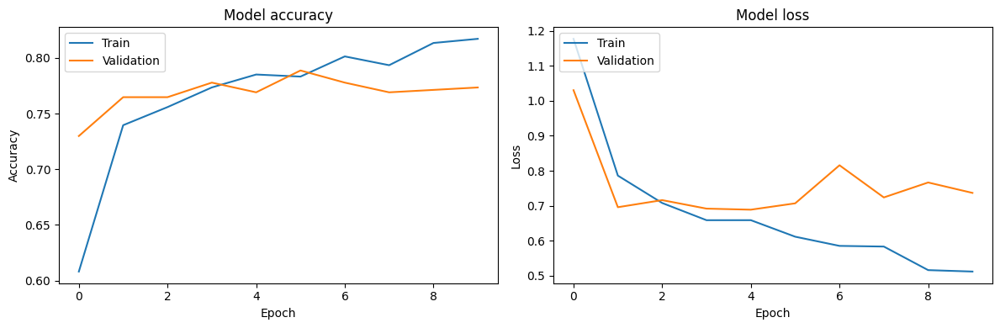

In [32]:
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

15/15 ━━━━━━━━━━━━━━━━━━━━ 7s 420ms/step - accuracy: 0.7913 - loss: 0.7333
Test Accuracy: 82.66%
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 124ms/step


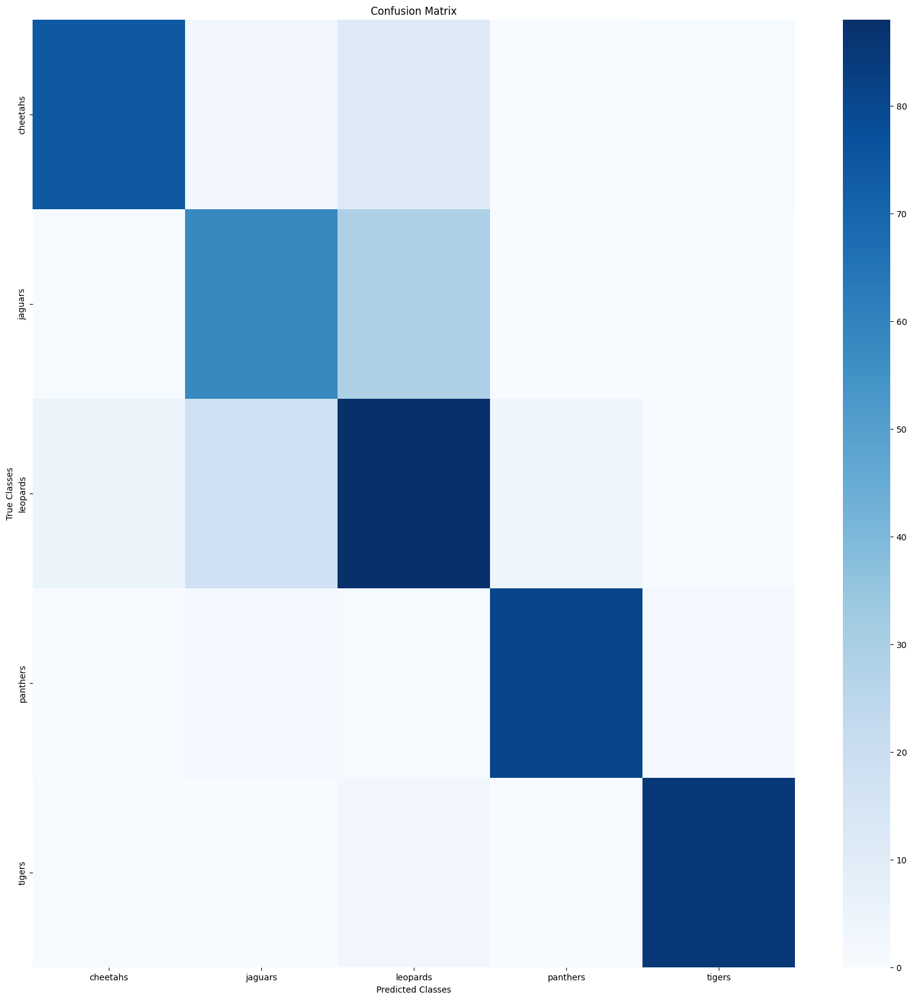

              precision    recall  f1-score   support

    cheetahs       0.91      0.83      0.87        89
     jaguars       0.72      0.66      0.69        88
    leopards       0.67      0.77      0.71       115
    panthers       0.95      0.94      0.95        86
      tigers       0.97      0.96      0.96        89

    accuracy                           0.83       467
   macro avg       0.84      0.83      0.84       467
weighted avg       0.83      0.83      0.83       467



In [33]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


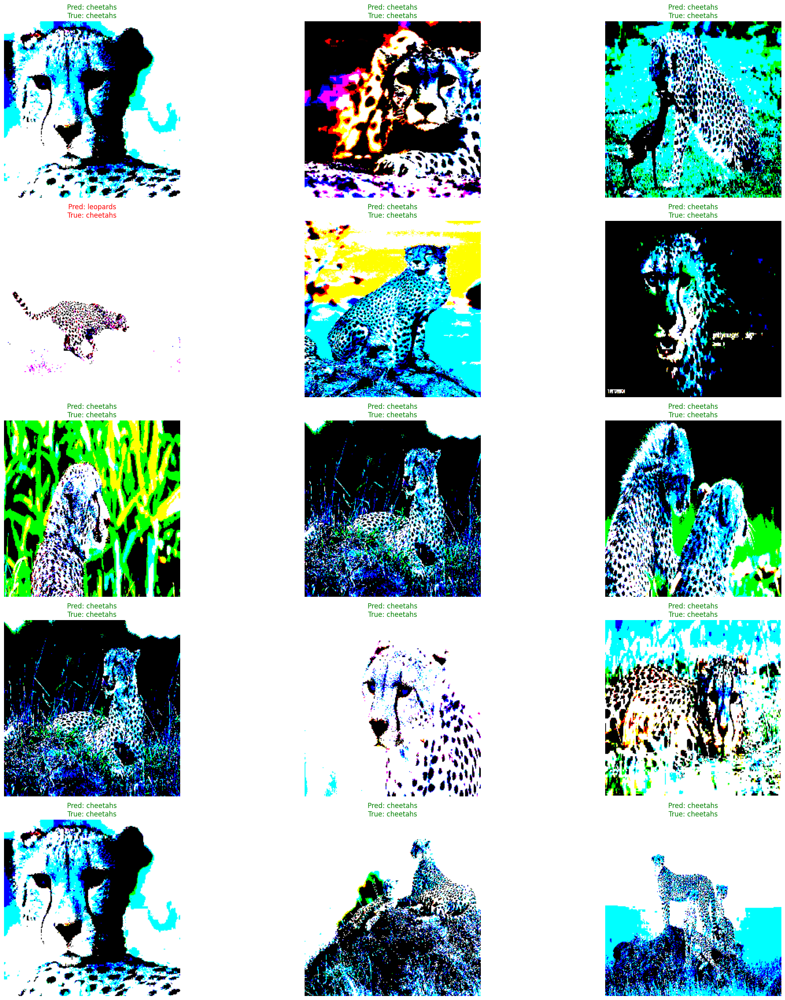

In [34]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]

        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization

        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


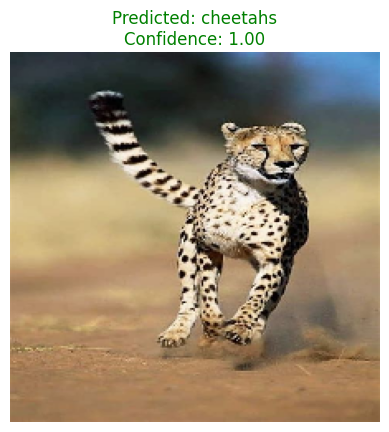

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


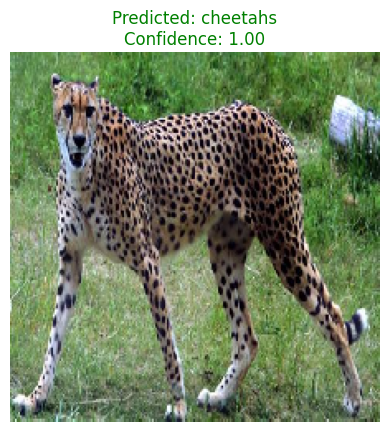

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


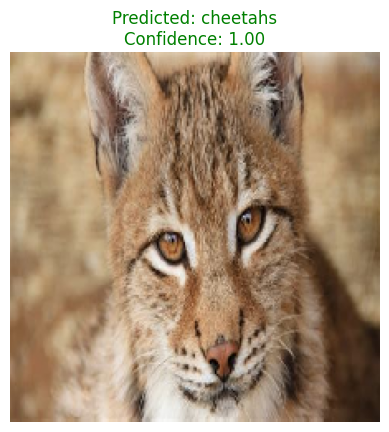

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


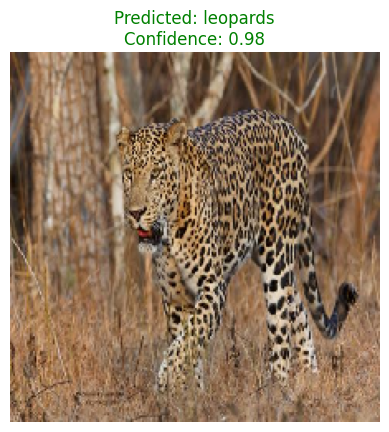

In [35]:
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

def test_single_image(img_path, model, class_names):
    """
    Tests a single image using the trained model and displays the predicted label.

    Args:
        img_path (str): Path to the image file.
        model (keras.Model): Trained model.
        class_names (list): List of class names.
    """
    # Load and preprocess the image
    img = image.load_img(img_path, target_size=(224, 224))  # Resize to model's input size
    img_array = image.img_to_array(img)  # Convert to numpy array
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array = preprocess_input(img_array)  # Preprocess using the same function as training

    # Make prediction
    prediction = model.predict(img_array)
    predicted_class = class_names[np.argmax(prediction)]  # Get the predicted class name
    confidence = np.max(prediction)  # Confidence score

    # Display the image and prediction
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Predicted: {predicted_class}\nConfidence: {confidence:.2f}", color='green')
    plt.show()

# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

***Resnet50***

In [36]:
#ResNet50
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import preprocess_input
train_dir = '/kaggle/working/output/train'
test_dir = '/kaggle/working/output/test'
val_dir = '/kaggle/working/output/val'
train_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
    )

# Validation/Test data generator without augmentation
valid_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
test_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create validation generator
validation_generator = train_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create test generator
test_generator = valid_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

Found 2154 images belonging to 5 classes.
Found 459 images belonging to 5 classes.
Found 467 images belonging to 5 classes.


In [37]:
from tensorflow.keras.applications import ResNet50
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    
    # Freeze the base model layers
for layer in base_model.layers[:-30]:  # Keep some layers trainable for fine-tuning
    layer.trainable = False
    
    # Add custom layers for classification
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(num_classes, activation='softmax')(x)
    
model = Model(inputs=base_model.input, outputs=predictions)

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [38]:
model.compile(
        optimizer=Adam(learning_rate=0.001),
        loss='categorical_crossentropy',
        metrics=['accuracy']
)
print(model.summary())

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 24,639,365 (93.99 MB)

 Trainable params: 15,501,829 (59.13 MB)

 Non-trainable params: 9,137,536 (34.86 MB)

None


In [39]:
callbacks = [
        ModelCheckpoint(
            'best_model.h5.keras',
            monitor='val_loss',
            save_best_only=True,
            mode='min',
            verbose=1
        ),
        ReduceLROnPlateau(
            monitor='val_loss',
            factor=0.2,
            patience=5,
            min_lr=1e-6,
            verbose=1
        ),
        EarlyStopping(
            monitor='val_loss',
            patience=10,
            restore_best_weights=True,
            verbose=1
        )
    ]

In [40]:
history = model.fit(
        train_generator,
        epochs=50,
        validation_data=validation_generator,
        callbacks=callbacks
    )

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step - accuracy: 0.6270 - loss: 1.1502
Epoch 1: val_loss improved from inf to 156.55882, saving model to best_model.h5.keras
68/68 ━━━━━━━━━━━━━━━━━━━━ 61s 600ms/step - accuracy: 0.6283 - loss: 1.1451 - val_accuracy: 0.2636 - val_loss: 156.5588 - learning_rate: 0.0010
Epoch 2/50
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step - accuracy: 0.8123 - loss: 0.5256
Epoch 2: val_loss improved from 156.55882 to 4.21248, saving model to best_model.h5.keras
68/68 ━━━━━━━━━━━━━━━━━━━━ 32s 437ms/step - accuracy: 0.8123 - loss: 0.5256 - val_accuracy: 0.5359 - val_loss: 4.2125 - learning_rate: 0.0010
Epoch 3/50
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step - accuracy: 0.8474 - loss: 0.4031
Epoch 3: val_loss improved from 4.21248 to 0.54653, saving model to best_model.h5.keras
68/68 ━━━━━━━━━━━━━━━━━━━━ 32s 427ms/step - accuracy: 0.8473 - loss: 0.4032 - val_accuracy: 0.8105 - val_loss: 0.5465 - learning_rate: 0.0010
Epoch 4/50
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step - accurac

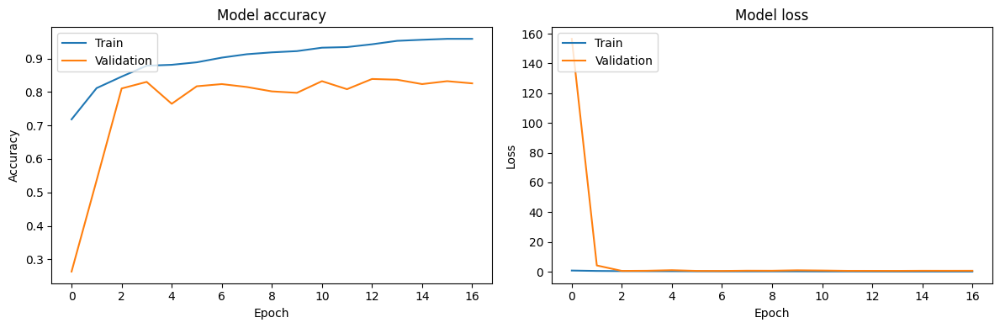

In [41]:
plt.figure(figsize=(12, 4))
    
# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
plt.tight_layout()
plt.show()

15/15 ━━━━━━━━━━━━━━━━━━━━ 4s 261ms/step - accuracy: 0.8645 - loss: 0.5437
Test Accuracy: 85.22%
15/15 ━━━━━━━━━━━━━━━━━━━━ 8s 294ms/step


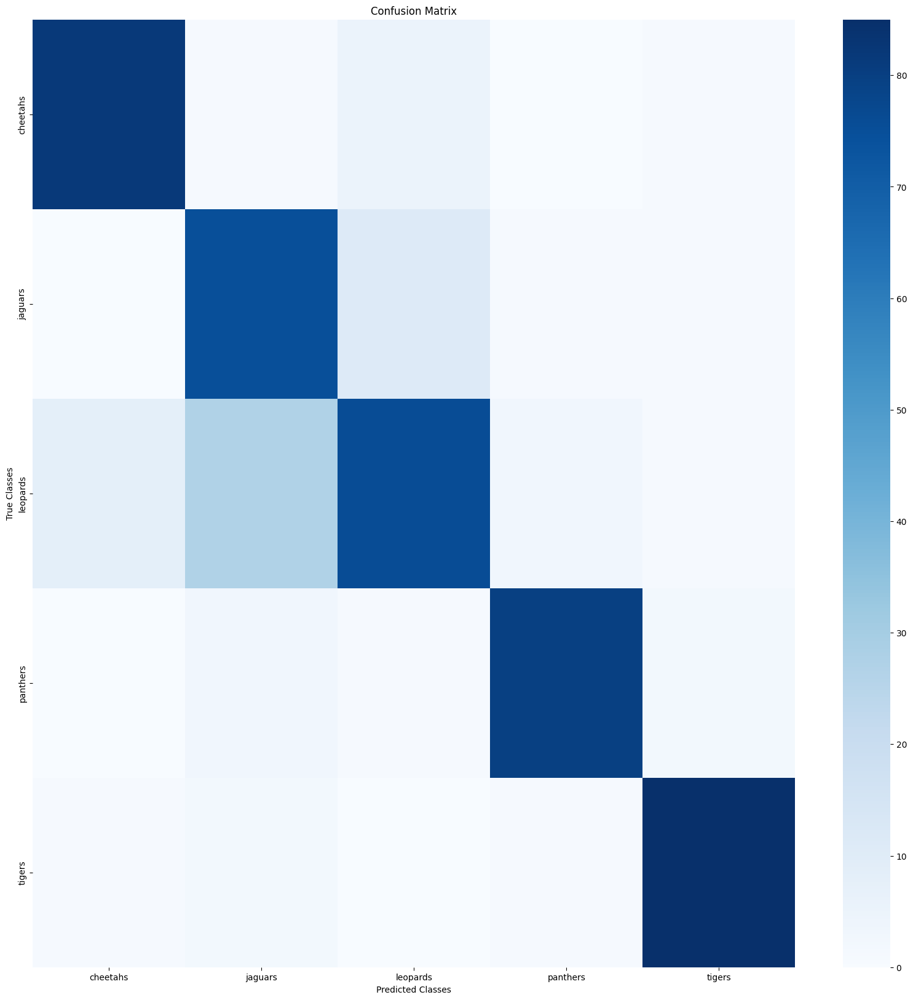

              precision    recall  f1-score   support

    cheetahs       0.90      0.92      0.91        89
     jaguars       0.69      0.85      0.77        88
    leopards       0.82      0.66      0.73       115
    panthers       0.94      0.93      0.94        86
      tigers       0.94      0.96      0.95        89

    accuracy                           0.85       467
   macro avg       0.86      0.86      0.86       467
weighted avg       0.86      0.85      0.85       467



In [42]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


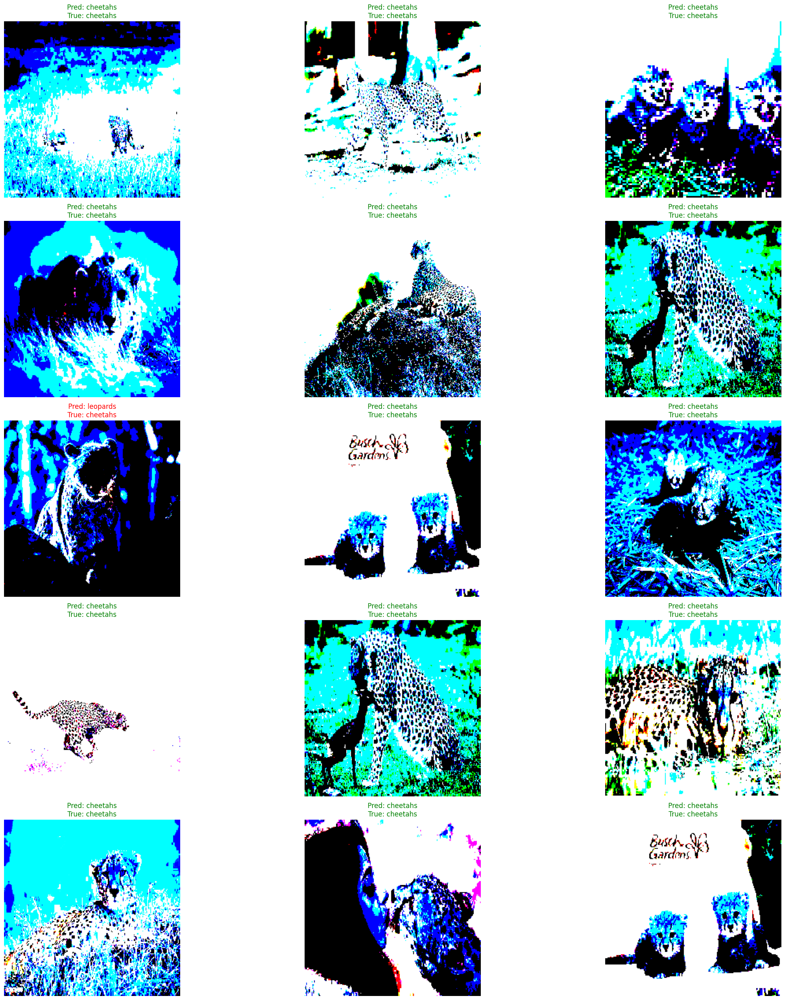

In [43]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]
        
        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization
        
        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


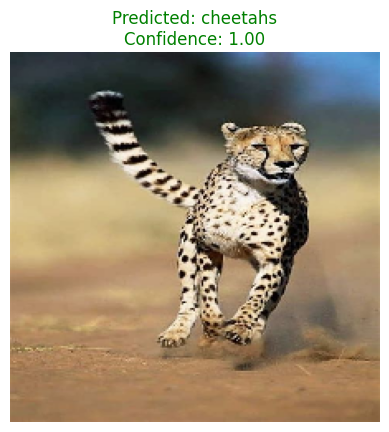

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


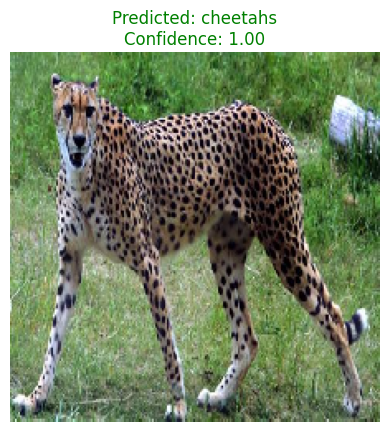

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


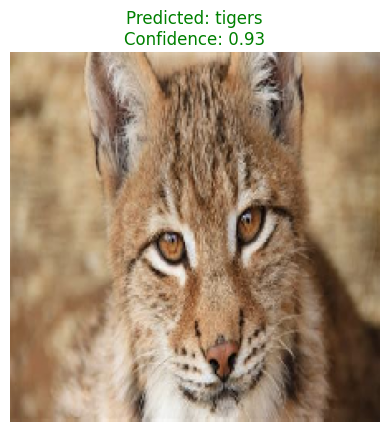

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


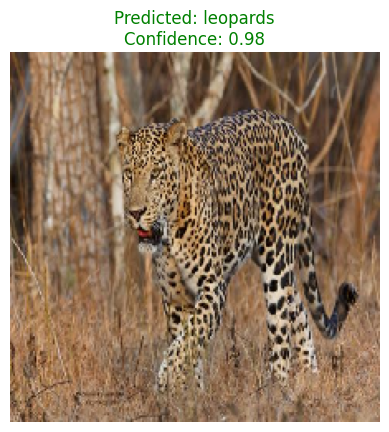

In [44]:
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

def test_single_image(img_path, model, class_names):
    """
    Tests a single image using the trained model and displays the predicted label.

    Args:
        img_path (str): Path to the image file.
        model (keras.Model): Trained model.
        class_names (list): List of class names.
    """
    # Load and preprocess the image
    img = image.load_img(img_path, target_size=(224, 224))  # Resize to model's input size
    img_array = image.img_to_array(img)  # Convert to numpy array
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array = preprocess_input(img_array)  # Preprocess using the same function as training

    # Make prediction
    prediction = model.predict(img_array)
    predicted_class = class_names[np.argmax(prediction)]  # Get the predicted class name
    confidence = np.max(prediction)  # Confidence score

    # Display the image and prediction
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Predicted: {predicted_class}\nConfidence: {confidence:.2f}", color='green')
    plt.show()

# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

***Experiment 3: ResNet SGD***

In [45]:
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    
    # Freeze the base model layers
for layer in base_model.layers[:-30]:  # Keep some layers trainable for fine-tuning
    layer.trainable = False
    
    # Add custom layers for classification
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(num_classes, activation='softmax')(x)
    
model = Model(inputs=base_model.input, outputs=predictions)

In [46]:
model.compile(
        optimizer=SGD(learning_rate=0.001),
        loss='categorical_crossentropy',
        metrics=['accuracy']
)
print(model.summary())

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer_3[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 24,639,365 (93.99 MB)

 Trainable params: 15,501,829 (59.13 MB)

 Non-trainable params: 9,137,536 (34.86 MB)

None


In [47]:
callbacks = [
        ModelCheckpoint(
            'best_model.h5.keras',
            monitor='val_loss',
            save_best_only=True,
            mode='min',
            verbose=1
        ),
        ReduceLROnPlateau(
            monitor='val_loss',
            factor=0.2,
            patience=5,
            min_lr=1e-6,
            verbose=1
        ),
        EarlyStopping(
            monitor='val_loss',
            patience=10,
            restore_best_weights=True,
            verbose=1
        )
    ]

In [48]:
history = model.fit(
        train_generator,
        epochs=50,
        validation_data=validation_generator,
        callbacks=callbacks
    )

Epoch 1/50
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step - accuracy: 0.2825 - loss: 1.8799
Epoch 1: val_loss improved from inf to 1.12078, saving model to best_model.h5.keras
68/68 ━━━━━━━━━━━━━━━━━━━━ 54s 579ms/step - accuracy: 0.2831 - loss: 1.8771 - val_accuracy: 0.5577 - val_loss: 1.1208 - learning_rate: 0.0010
Epoch 2/50
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step - accuracy: 0.4866 - loss: 1.2795
Epoch 2: val_loss improved from 1.12078 to 0.83422, saving model to best_model.h5.keras
68/68 ━━━━━━━━━━━━━━━━━━━━ 33s 455ms/step - accuracy: 0.4869 - loss: 1.2786 - val_accuracy: 0.7364 - val_loss: 0.8342 - learning_rate: 0.0010
Epoch 3/50
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step - accuracy: 0.6021 - loss: 1.0402
Epoch 3: val_loss improved from 0.83422 to 0.71698, saving model to best_model.h5.keras
68/68 ━━━━━━━━━━━━━━━━━━━━ 33s 447ms/step - accuracy: 0.6024 - loss: 1.0394 - val_accuracy: 0.7298 - val_loss: 0.7170 - learning_rate: 0.0010
Epoch 4/50
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step - ac

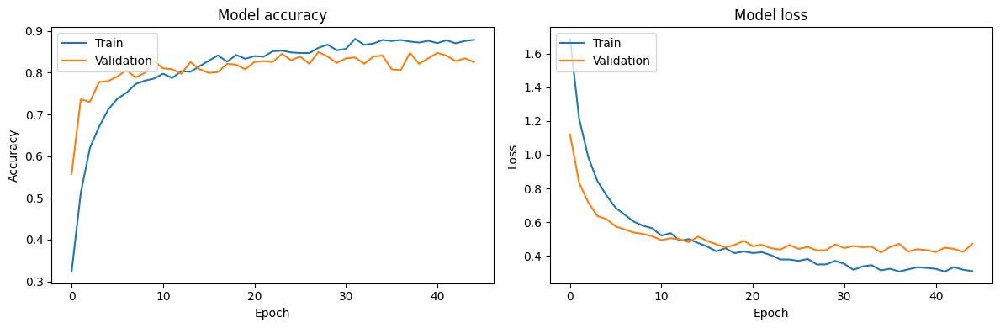

In [49]:
plt.figure(figsize=(12, 4))
    
# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
plt.tight_layout()
plt.show()

15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 178ms/step - accuracy: 0.8585 - loss: 0.4119
Test Accuracy: 86.30%
15/15 ━━━━━━━━━━━━━━━━━━━━ 7s 277ms/step


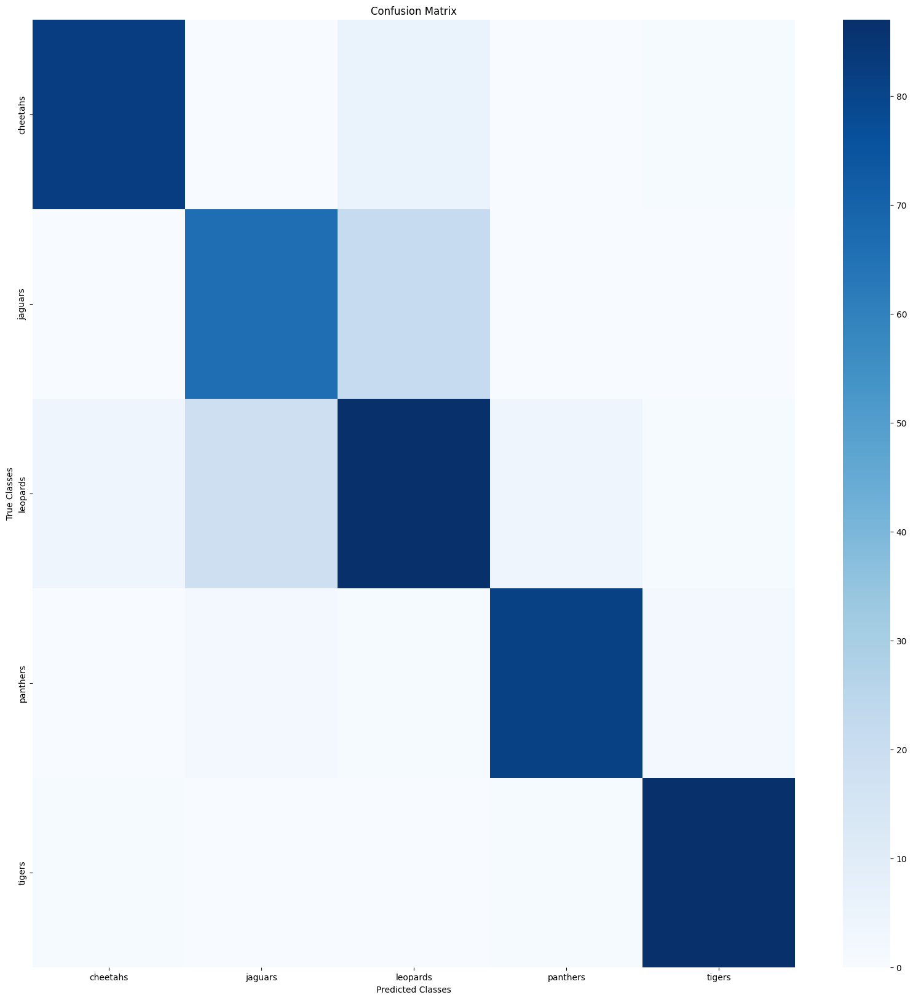

              precision    recall  f1-score   support

    cheetahs       0.94      0.92      0.93        89
     jaguars       0.76      0.75      0.75        88
    leopards       0.75      0.76      0.75       115
    panthers       0.94      0.94      0.94        86
      tigers       0.96      0.98      0.97        89

    accuracy                           0.86       467
   macro avg       0.87      0.87      0.87       467
weighted avg       0.86      0.86      0.86       467



In [50]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


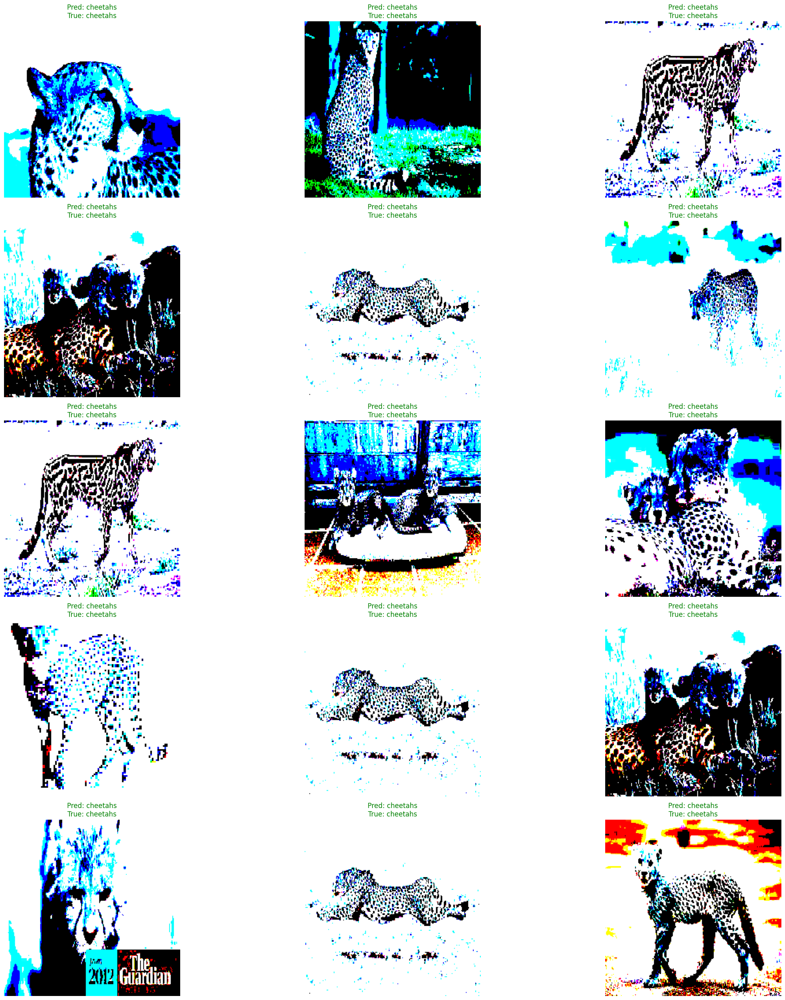

In [51]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]
        
        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization
        
        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


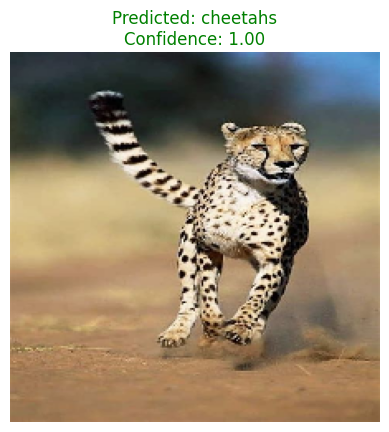

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


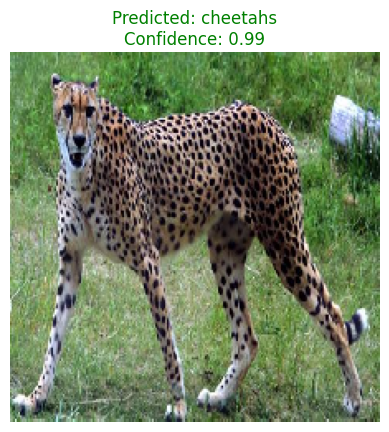

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


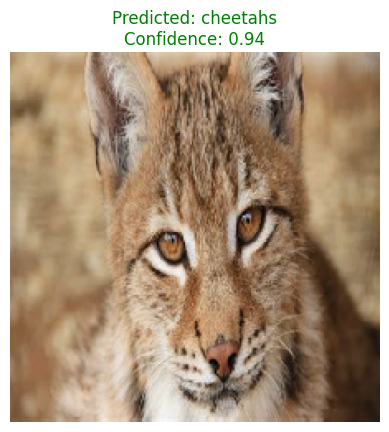

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


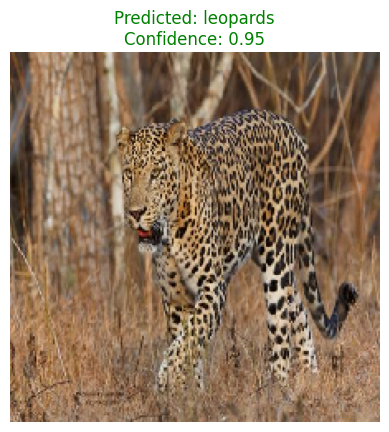

In [52]:
# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

**Experiment 4: VGG16**

In [53]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.vgg16 import preprocess_input
train_dir = '/kaggle/working/output/train'
test_dir = '/kaggle/working/output/test'
val_dir = '/kaggle/working/output/val'
train_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
    )

# Validation/Test data generator without augmentation
valid_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
test_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create validation generator
validation_generator = train_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create test generator
test_generator = valid_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

Found 2154 images belonging to 5 classes.
Found 459 images belonging to 5 classes.
Found 467 images belonging to 5 classes.


In [54]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D,BatchNormalization
from tensorflow.keras.models import Model, Sequential
base_model=VGG16(weights='imagenet',include_top=False, input_shape=(224,224,3))
x = base_model.output
x = Flatten()(x)
x = Dropout(0.4)(x)
# let's add two fully-connected layer
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
# and a softmax layer -- let's say we have 200 classes
predictions = Dense(num_classes, activation='softmax')(x)

# this is the model we will train
model = Model(inputs=base_model.input, outputs=predictions)

# first: train only the top layers (which were randomly initialized)
# i.e. freeze all convolutional InceptionV3 layers
for layer in base_model.layers:
    layer.trainable = False

# compile the model (should be done *after* setting layers to non-trainable)
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

print(model.summary())

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 70,319,941 (268.25 MB)

 Trainable params: 55,597,061 (212.09 MB)

 Non-trainable params: 14,722,880 (56.16 MB)

None


In [55]:
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping, ReduceLROnPlateau
#from tensorflow.keras.optimizers import Adam,SGD
checkpoint = ModelCheckpoint(
    './base.model.keras',
    monitor='val_loss',
    verbose=2,
    save_best_only=True,
    mode='min',
    save_weights_only=False,
)
earlystop = EarlyStopping(
    monitor='val_loss',
    min_delta=0.00001,
    patience=5,
    verbose=1,
    mode='auto'
)
reduce = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.1,
    patience=3,
    verbose=1,
    mode='auto'
)

In [56]:
history = model.fit(
        train_generator,
        epochs=15,
        validation_data=validation_generator,
        callbacks=[checkpoint, earlystop]
    )

Epoch 1/15


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step - accuracy: 0.5190 - loss: 1.4217
Epoch 1: val_loss improved from inf to 0.99082, saving model to ./base.model.keras
68/68 ━━━━━━━━━━━━━━━━━━━━ 40s 509ms/step - accuracy: 0.5206 - loss: 1.4174 - val_accuracy: 0.7429 - val_loss: 0.9908
Epoch 2/15
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step - accuracy: 0.7414 - loss: 0.7928
Epoch 2: val_loss improved from 0.99082 to 0.74700, saving model to ./base.model.keras
68/68 ━━━━━━━━━━━━━━━━━━━━ 35s 469ms/step - accuracy: 0.7413 - loss: 0.7929 - val_accuracy: 0.7560 - val_loss: 0.7470
Epoch 3/15
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step - accuracy: 0.7331 - loss: 0.7536
Epoch 3: val_loss improved from 0.74700 to 0.73005, saving model to ./base.model.keras
68/68 ━━━━━━━━━━━━━━━━━━━━ 35s 476ms/step - accuracy: 0.7334 - loss: 0.7528 - val_accuracy: 0.7625 - val_loss: 0.7300
Epoch 4/15
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step - accuracy: 0.7756 - loss: 0.6909
Epoch 4: val_loss did not improve from 0.73005
68/68 ━━━

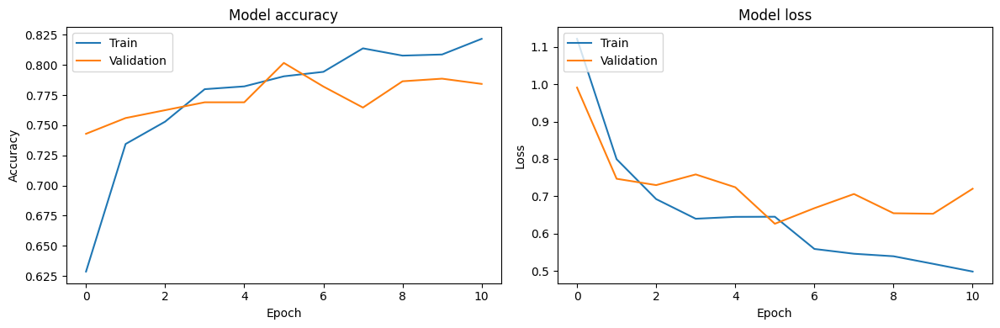

In [57]:
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 125ms/step - accuracy: 0.8098 - loss: 0.6415
Test Accuracy: 83.08%
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 117ms/step


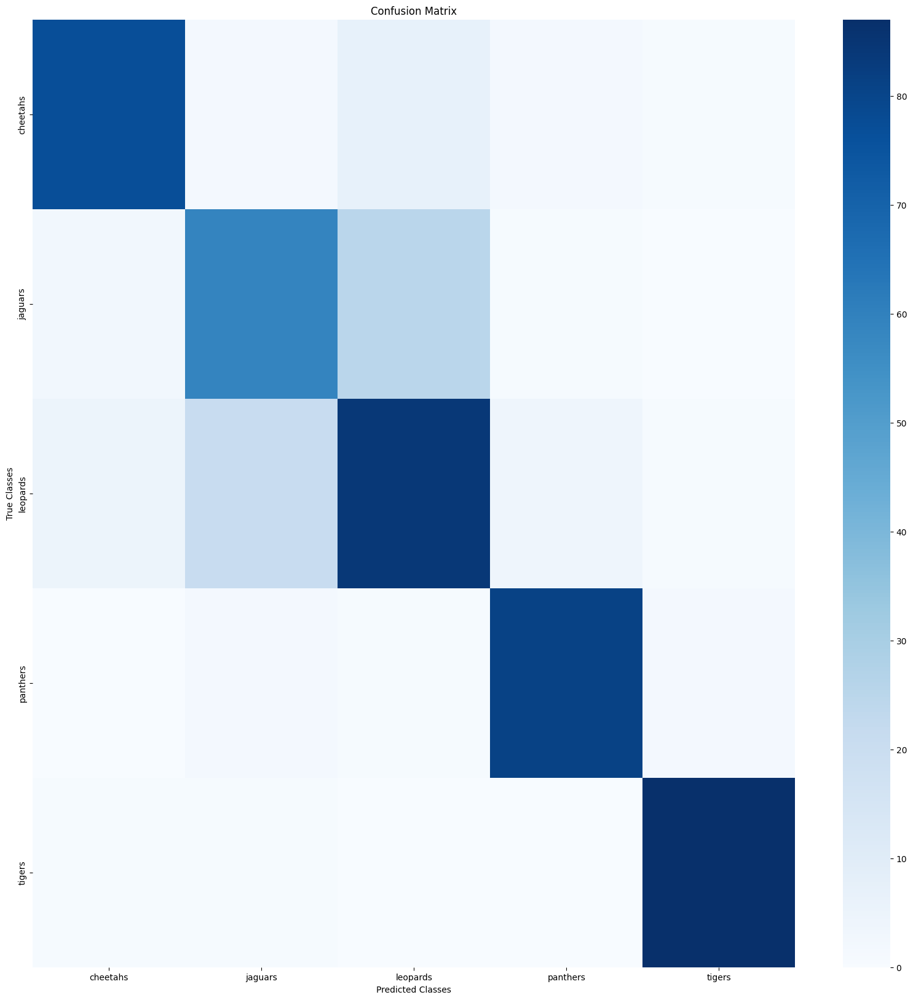

              precision    recall  f1-score   support

    cheetahs       0.90      0.87      0.88        89
     jaguars       0.69      0.67      0.68        88
    leopards       0.72      0.73      0.72       115
    panthers       0.92      0.94      0.93        86
      tigers       0.96      0.98      0.97        89

    accuracy                           0.83       467
   macro avg       0.84      0.84      0.84       467
weighted avg       0.83      0.83      0.83       467



In [58]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


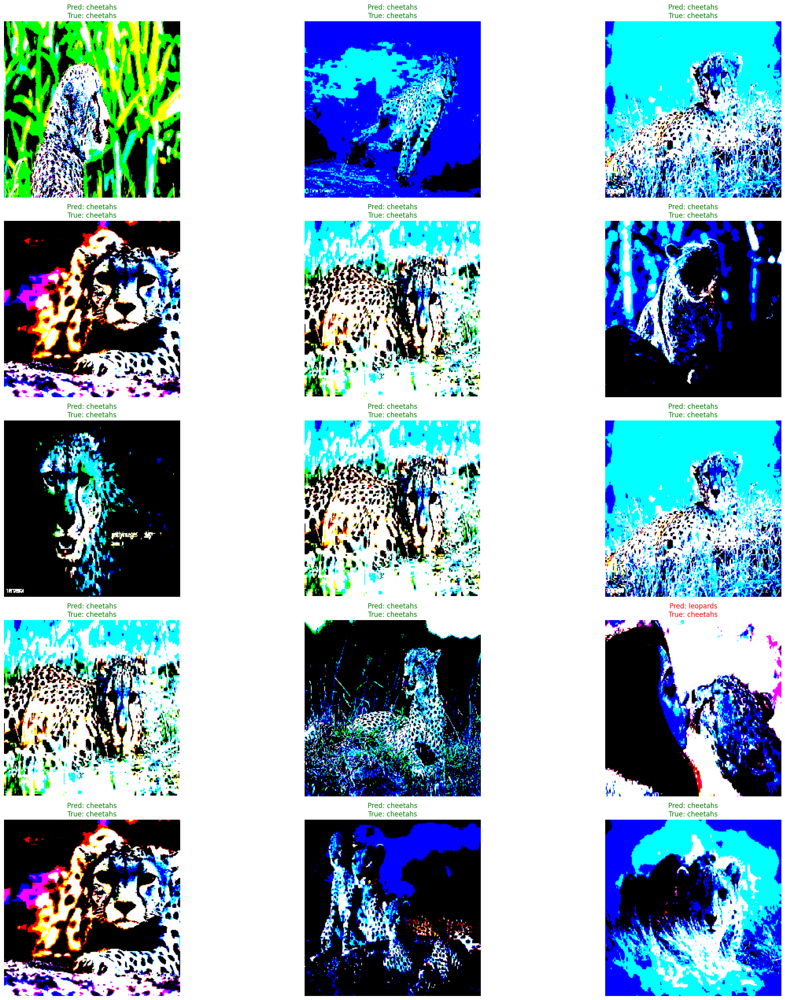

In [59]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]

        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization

        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


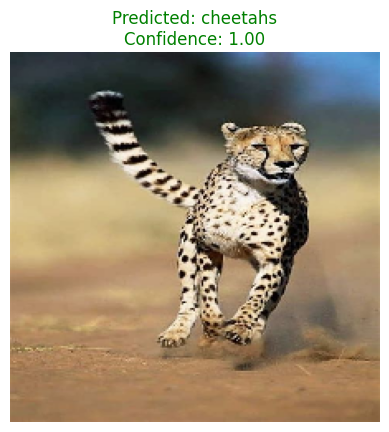

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


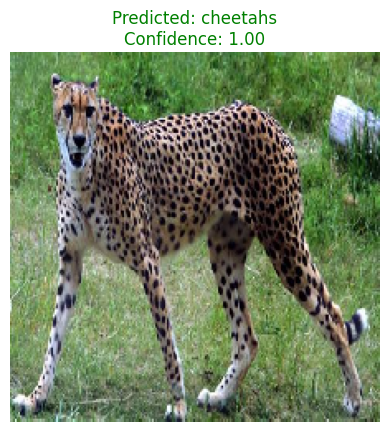

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


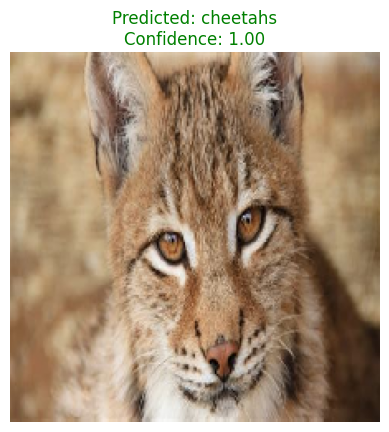

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


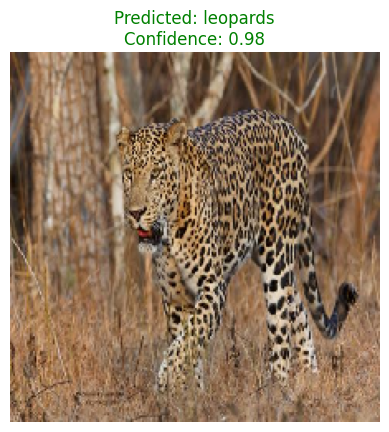

In [60]:
# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

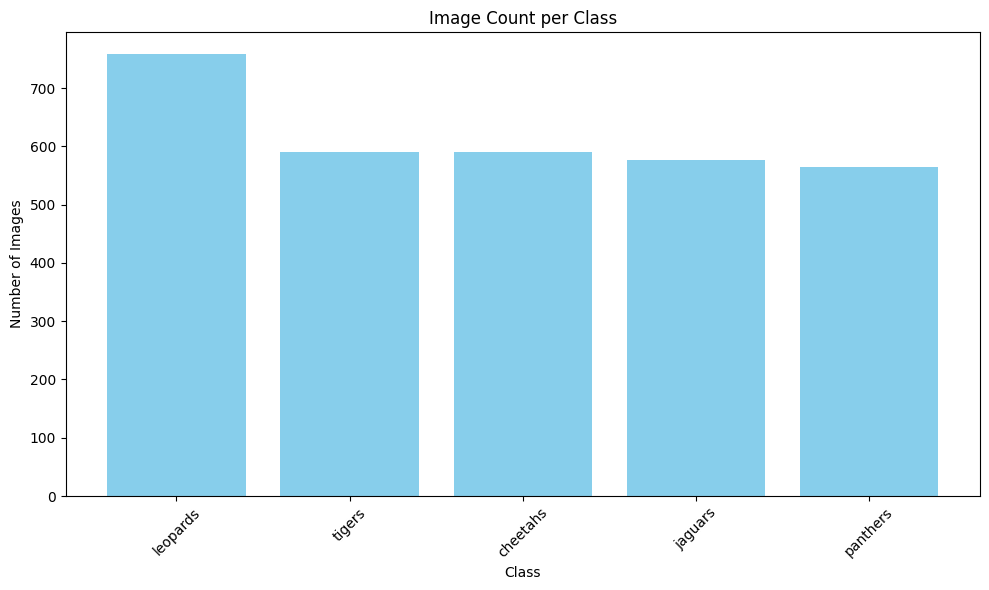

In [61]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Path to your dataset directory (each class is a folder)
dataset_dir = path

# Get class names and image counts
data = []
for class_name in os.listdir(dataset_dir):
    class_path = os.path.join(dataset_dir, class_name)
    if os.path.isdir(class_path):
        image_count = len([f for f in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, f))])
        data.append({'Class': class_name, 'Image Count': image_count})

# Create DataFrame
df = pd.DataFrame(data)

# Sort by image count (optional)
df = df.sort_values('Image Count', ascending=False)

# Plot
plt.figure(figsize=(10, 6))
plt.bar(df['Class'], df['Image Count'], color='skyblue')
plt.xlabel('Class')
plt.ylabel('Number of Images')
plt.title('Image Count per Class')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [62]:
# Add percentage column
df['Percentage'] = (df['Image Count'] / df['Image Count'].sum()) * 100

# Display the table
print(df)

# Optional: Round percentages
df['Percentage'] = df['Percentage'].round(2)

      Class  Image Count  Percentage
2  leopards          758   24.610390
3    tigers          590   19.155844
1  cheetahs          590   19.155844
4   jaguars          577   18.733766
0  panthers          565   18.344156


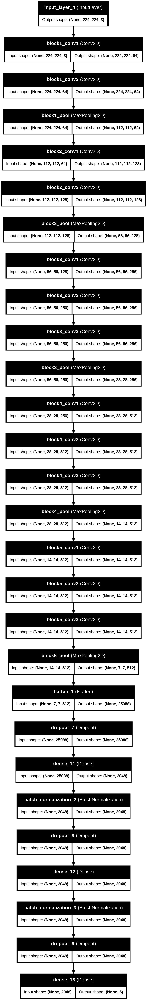

In [63]:
from tensorflow.keras.utils import plot_model

plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True)
